## Tries on relation embedding

https://github.com/fmtumbuka/RelationEmbeddings

## Data loading and Libraries

Libraries:

In [1]:
# Import necessary libraries
import ADDLIB.RelationEmbeddings.src.main.python.relcore.pre_trained_encoders.relation_encoder as relation_enc

from DATA.relations import relation_mapping
import pandas as pd
import json
import re

import numpy as np
import umap
import hdbscan
import plotly.express as px

from datetime import datetime

/home/p0l3/miniconda3/envs/promptore/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Model: 

In [2]:
# Load the pre-trained relation encoder based on BERT
bert_model = relation_enc.RelationEncoder.from_pretrained("fmmka/rel-emb-albert")
# Access the tokenizer from the model
tokenizer = bert_model.tokenizer


/home/p0l3/miniconda3/envs/promptore/lib/python3.8/site-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of the model checkpoint at albert-xxlarge-v1 were not used when initializing AlbertModel: ['predictions.dense.weight', 'predictions.bias', 'predictions.decoder.bias', 'predictions.dense.bias', 'predictions.LayerNorm.weight', 'predictions.decoder.weight', 'predictions.LayerNorm.bias']
- This IS expected if you are initializing AlbertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing AlbertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceCl

Helper function:

In [3]:

def parse_labelstudio(path: str, expand: bool = False) -> pd.DataFrame:
    with open(path, "r", encoding="utf-8") as file:
        dataset = json.load(file)
        
    ls_tuples = []    
    for entry in dataset:
        annotations = entry.get("annotations", [])
        data = entry.get("data", {})

        sentence = data.get("sentence", "")
        paper_id = data.get("paper_id")
        sentence_id = data.get("sentence_id")
        
        for annotation in annotations:
            results = annotation.get("result", [])
            entities = {e["id"]: e["value"] for e in results if e["type"] == "labels"}
            relations = [r for r in results if r["type"] == "relation"]

            for relation in relations:
                from_id = relation["from_id"]
                to_id = relation["to_id"]
                direction = relation["direction"]
                relation_type = relation.get("labels", [""])[0] or "0"
                relation_name = relation_mapping.get(int(relation_type), "")

                # Get entity spans
                e1_value = entities.get(from_id if direction == "right" else to_id, {})
                e2_value = entities.get(to_id if direction == "right" else from_id, {})

                e1_text = e1_value.get("text", "")
                e1_start = e1_value.get("start", -1)
                e1_end = e1_value.get("end", -1)

                e2_text = e2_value.get("text", "")
                e2_start = e2_value.get("start", -1)
                e2_end = e2_value.get("end", -1)

                # Insert entity markers into the sentence
                # Sort to insert from the back to preserve character indices
                spans = sorted([
                    (e1_start, e1_end, "[E1] ", " [/E1]"),
                    (e2_start, e2_end, "[E2] ", " [/E2]")
                ], key=lambda x: x[0], reverse=True)

                marked_sentence = sentence
                for start, end, start_tag, end_tag in spans:
                    marked_sentence = marked_sentence[:end] + end_tag + marked_sentence[end:]
                    marked_sentence = marked_sentence[:start] + start_tag + marked_sentence[start:]

                # Add prompt
                prompt = f" The relation between {e1_text} and {e2_text} is [MASK]."
                full_sentence = marked_sentence + prompt

                ls_tuples.append({
                    'sent': full_sentence,
                    'r': relation_name,
                    'e1': e1_text,
                    'e2': e2_text,
                    'paper_id': paper_id,
                    'sentence_id': sentence_id
                })

                # If bidirectional, add the reverse too
                if direction == "undirected":
                    prompt = f" The relation between {e2_text} and {e1_text} is [MASK]."
                    full_sentence_rev = marked_sentence + prompt
                    ls_tuples.append({
                        'sent': full_sentence_rev,
                        'r': relation_name,
                        'e1': e2_text,
                        'e2': e1_text,
                        'paper_id': paper_id,
                        'sentence_id': sentence_id
                    })

    return pd.DataFrame(ls_tuples)


Data:

In [4]:
df = parse_labelstudio("DATA/project-6-at-2025-04-22-13-14-67864b63.json")

## Embeding creation (Use only if creating new)

In [50]:
# 1447it [00:55, 25.86it/s]
import torch
from tqdm import tqdm
import pandas as pd

data_list = []
emb_type = "mask"

for i, row in tqdm(df.iterrows()):
    relation_sample = {
        "id": i,
        "paper_id" : row["paper_id"],
        "sentence_id": row["sentence_id"],
        "sentence": row["sent"],
        "e1": row["e1"],
        "r": row["r"],
        "e2": row["e2"],
        "emb_t": emb_type,
    }
    

    # Tokenize the input sentence
    inputs = tokenizer(row["sent"], return_tensors="pt")
    tokens = tokenizer.tokenize(row["sent"])

    # Locate the indices for the special markers and [MASK] token
    e1_index = tokens.index(bert_model.start_of_head_entity)  # Index of the [E1] token
    e2_index = tokens.index(bert_model.start_of_tail_entity)  # Index of the [E2] token
    mask_index = tokens.index(bert_model.mask_token)  # Index of the [MASK] token

    # Compute outputs using the model
    outputs = bert_model(inputs)

    # Extract embeddings for [E1], [E2], and [MASK]
    if emb_type == "e1":
        emb = outputs[:, e1_index, :].flatten().tolist()   # Embedding for [E1]
    elif emb_type == "e2":
        emb = outputs[:, e2_index, :].flatten().tolist()  # Embedding for [E2]
    elif emb_type == "mask":
        emb = outputs[:, mask_index, :].flatten().tolist()  # Embedding for [MASK]
    elif emb_type == "concat":
        emb_e1 = outputs[:, e1_index, :]  # Embedding for [E1]
        emb_e2 = outputs[:, e2_index, :]  # Embedding for [E2]
        emb_mask = outputs[:, mask_index, :]  # Embedding for [MASK]
        
        emb = torch.cat((emb_e1.flatten(), emb_e2.flatten(), emb_mask.flatten())).tolist()
    else:
        emb = ["ERROR"]
        print("No correct embedding setup chosen ...")
        
    for j, e in enumerate(emb):
        relation_sample[f"{j+1}"] = e
    
    data_list.append(relation_sample)
        
    # print(relation_sample)
    
relational_emb = pd.DataFrame(data_list)
relational_emb.to_csv(f"relemb_mtambuka_{len(df)}_{emb_type}.csv")

1447it [01:01, 23.41it/s]


## Embedding usage

Load desired embeddings:

In [21]:
file_name = "relemb_mtambuka_1447_concat.csv"
relational_emb = pd.read_csv(file_name)
emb_type = file_name.split(".")[0].split("_")[-1]


In [22]:
import plotly.express as px

# Plotly's histogram function can count categories directly.
# We sort the categories by frequency for a cleaner look.
fig = px.histogram(
    relational_emb,
    y='r',  # Use 'y' for a horizontal plot
    title='Interactive Frequency of Each Relation Type',
    labels={'r': 'Relation Type', 'count': 'Frequency'}
)

# Update layout to sort the bars from most frequent at the top to least at the bottom
fig.update_layout(
    yaxis={'categoryorder':'total ascending'}
)

fig.show()

In [23]:
# Filter by just a few relations (optional)
relational_emb = relational_emb[relational_emb["r"].isin(["is a disease of", "causes", "has mathematical error", "causes a decrease in concentration of", "chamical causes"])]

# --- 2. Isolate Embeddings ---
# Find the first embedding column (assuming it's named '1')
first_embedding_col_index = relational_emb.columns.get_loc('1')
# Select all columns from the first embedding column to the end



embedding_vectors = relational_emb.iloc[:, first_embedding_col_index:].values

print(f"\nExtracted {embedding_vectors.shape[0]} embeddings of dimension {embedding_vectors.shape[1]}")


Extracted 67 embeddings of dimension 2304


#### UMAP experiments

In [34]:
# --- 3. Dimensionality Reduction with UMAP (to 2D) ---
# We reduce to 2 components for a 2D plot. random_state ensures reproducibility.
print("\nReducing dimensions with UMAP...")
reducer = umap.UMAP(n_components=2, random_state=42, n_neighbors=15, min_dist=0.1)
embeddings_2d = reducer.fit_transform(embedding_vectors)

# Add the 2D coordinates to the DataFrame for easy plotting
relational_emb['x'] = embeddings_2d[:, 0]
relational_emb['y'] = embeddings_2d[:, 1]


# --- 4. Clustering with HDBSCAN ---
# We cluster on the ORIGINAL high-dimensional data for best results.
# min_cluster_size is the most important parameter to tune.
print("Performing clustering with HDBSCAN...")
clusterer = hdbscan.HDBSCAN(min_cluster_size=5, gen_min_span_tree=True)
clusterer.fit(embedding_vectors)

# Add the cluster labels to the DataFrame. -1 means the point is considered noise.
relational_emb['cluster'] = clusterer.labels_

print(f"\nFound {len(np.unique(clusterer.labels_)) - 1} clusters.")
print("Cluster counts:")
print(relational_emb['cluster'].value_counts())


# --- 5. Interactive Visualization with Plotly ---
print("\nCreating interactive plot...")
fig = px.scatter(
    relational_emb,
    x='x',
    y='y',
    # Color by the cluster label. Converting to string treats it as a discrete category.
    color=relational_emb['cluster'].astype(str),
    # This text appears in bold at the top of the hover tooltip
    hover_name='r',
    # Customize the data shown on hover
    hover_data={
        'sentence': True,  # Show the full sentence
        'e1': True,        # Show entity 1
        'e2': True,        # Show entity 2
        'cluster': True,   # Show the cluster number
        'x': False,        # Hide the x-coordinate
        'y': False         # Hide the y-coordinate
    },
    title="Interactive UMAP Projection of Sentence Embeddings",
    labels={'color': 'Cluster ID'} # Legend title
)

fig.update_traces(marker=dict(size=6, opacity=0.8))
fig.update_layout(
    legend_title_text='Cluster ID',
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Rockwell"
    )
)

# Show the plot. This will open in your browser or a new window in your IDE.
dt = datetime.now()

fig.write_html(f"relemb_{emb_type}_{dt.day}{dt.month}{dt.year}_{dt.hour}_{dt.second}_UMAP.html")
fig.show()


Reducing dimensions with UMAP...
Performing clustering with HDBSCAN...

Found 2 clusters.
Cluster counts:
cluster
-1    33
 0    17
 1    17
Name: count, dtype: int64

Creating interactive plot...


/home/p0l3/miniconda3/envs/promptore/lib/python3.8/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



#### Agglomerative Experiments

In [19]:
      
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

# --- Clustering with AgglomerativeClustering ---
# Specify the number of clusters you want to end up with
n_clusters = 5
agg_cluster = AgglomerativeClustering(n_clusters=n_clusters)
clusters = agg_cluster.fit_predict(embedding_vectors)

# Add the cluster labels to your DataFrame
relational_emb['cluster'] = clusters

# --- Visualization (Plotly Scatter - same as before) ---
fig = px.scatter(
    relational_emb,
    x='x',
    y='y',
    color=relational_emb['cluster'].astype(str),
    hover_name='r',
    hover_data={'sentence': False, 'e1': True, 'e2': True, 'cluster': True},
    title=f"Agglomerative Clustering (n={n_clusters})",
    labels={'color': 'Cluster ID'}
)

dt = datetime.now()

fig.write_html(f"relemb_{emb_type}_{dt.day}{dt.month}{dt.year}_{dt.hour}_{dt.second}_AC.html")
fig.show()

# --- BONUS: Visualize the Dendrogram ---
# This helps you choose the right number of clusters!
print("\nGenerating dendrogram...")
# Using 'ward' linkage is a good default
linked = linkage(embedding_vectors, method='ward')

plt.figure(figsize=(12, 8))
dendrogram(linked,
           orientation='top',
           distance_sort='descending',
           show_leaf_counts=True)
plt.title('Dendrogram for Hierarchical Clustering')
plt.xlabel('Sample Index')
plt.ylabel('Distance (Ward)')


plt.show() # Look for the longest vertical lines to find natural cut points

    

ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['Unnamed: 0', 'id', 'paper_id', 'sentence_id', 'sentence', 'e1', 'r', 'e2', 'emb_t', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135', '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '148', '149', '150', '151', '152', '153', '154', '155', '156', '157', '158', '159', '160', '161', '162', '163', '164', '165', '166', '167', '168', '169', '170', '171', '172', '173', '174', '175', '176', '177', '178', '179', '180', '181', '182', '183', '184', '185', '186', '187', '188', '189', '190', '191', '192', '193', '194', '195', '196', '197', '198', '199', '200', '201', '202', '203', '204', '205', '206', '207', '208', '209', '210', '211', '212', '213', '214', '215', '216', '217', '218', '219', '220', '221', '222', '223', '224', '225', '226', '227', '228', '229', '230', '231', '232', '233', '234', '235', '236', '237', '238', '239', '240', '241', '242', '243', '244', '245', '246', '247', '248', '249', '250', '251', '252', '253', '254', '255', '256', '257', '258', '259', '260', '261', '262', '263', '264', '265', '266', '267', '268', '269', '270', '271', '272', '273', '274', '275', '276', '277', '278', '279', '280', '281', '282', '283', '284', '285', '286', '287', '288', '289', '290', '291', '292', '293', '294', '295', '296', '297', '298', '299', '300', '301', '302', '303', '304', '305', '306', '307', '308', '309', '310', '311', '312', '313', '314', '315', '316', '317', '318', '319', '320', '321', '322', '323', '324', '325', '326', '327', '328', '329', '330', '331', '332', '333', '334', '335', '336', '337', '338', '339', '340', '341', '342', '343', '344', '345', '346', '347', '348', '349', '350', '351', '352', '353', '354', '355', '356', '357', '358', '359', '360', '361', '362', '363', '364', '365', '366', '367', '368', '369', '370', '371', '372', '373', '374', '375', '376', '377', '378', '379', '380', '381', '382', '383', '384', '385', '386', '387', '388', '389', '390', '391', '392', '393', '394', '395', '396', '397', '398', '399', '400', '401', '402', '403', '404', '405', '406', '407', '408', '409', '410', '411', '412', '413', '414', '415', '416', '417', '418', '419', '420', '421', '422', '423', '424', '425', '426', '427', '428', '429', '430', '431', '432', '433', '434', '435', '436', '437', '438', '439', '440', '441', '442', '443', '444', '445', '446', '447', '448', '449', '450', '451', '452', '453', '454', '455', '456', '457', '458', '459', '460', '461', '462', '463', '464', '465', '466', '467', '468', '469', '470', '471', '472', '473', '474', '475', '476', '477', '478', '479', '480', '481', '482', '483', '484', '485', '486', '487', '488', '489', '490', '491', '492', '493', '494', '495', '496', '497', '498', '499', '500', '501', '502', '503', '504', '505', '506', '507', '508', '509', '510', '511', '512', '513', '514', '515', '516', '517', '518', '519', '520', '521', '522', '523', '524', '525', '526', '527', '528', '529', '530', '531', '532', '533', '534', '535', '536', '537', '538', '539', '540', '541', '542', '543', '544', '545', '546', '547', '548', '549', '550', '551', '552', '553', '554', '555', '556', '557', '558', '559', '560', '561', '562', '563', '564', '565', '566', '567', '568', '569', '570', '571', '572', '573', '574', '575', '576', '577', '578', '579', '580', '581', '582', '583', '584', '585', '586', '587', '588', '589', '590', '591', '592', '593', '594', '595', '596', '597', '598', '599', '600', '601', '602', '603', '604', '605', '606', '607', '608', '609', '610', '611', '612', '613', '614', '615', '616', '617', '618', '619', '620', '621', '622', '623', '624', '625', '626', '627', '628', '629', '630', '631', '632', '633', '634', '635', '636', '637', '638', '639', '640', '641', '642', '643', '644', '645', '646', '647', '648', '649', '650', '651', '652', '653', '654', '655', '656', '657', '658', '659', '660', '661', '662', '663', '664', '665', '666', '667', '668', '669', '670', '671', '672', '673', '674', '675', '676', '677', '678', '679', '680', '681', '682', '683', '684', '685', '686', '687', '688', '689', '690', '691', '692', '693', '694', '695', '696', '697', '698', '699', '700', '701', '702', '703', '704', '705', '706', '707', '708', '709', '710', '711', '712', '713', '714', '715', '716', '717', '718', '719', '720', '721', '722', '723', '724', '725', '726', '727', '728', '729', '730', '731', '732', '733', '734', '735', '736', '737', '738', '739', '740', '741', '742', '743', '744', '745', '746', '747', '748', '749', '750', '751', '752', '753', '754', '755', '756', '757', '758', '759', '760', '761', '762', '763', '764', '765', '766', '767', '768', 'cluster'] but received: x

In [33]:
import pandas as pd
import numpy as np
import umap
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import KNeighborsClassifier
import plotly.graph_objects as go
from datetime import datetime

# --- Assume your previous code has been run ---
# relational_emb DataFrame is ready with embeddings
# embedding_vectors are extracted (full 768 dimensions)

# --- 1. UMAP Reduction (same as before) ---
reducer = umap.UMAP(n_components=2, random_state=3005, n_neighbors=15, min_dist=0.1)
embeddings_2d = reducer.fit_transform(embedding_vectors)
relational_emb['x'] = embeddings_2d[:, 0]
relational_emb['y'] = embeddings_2d[:, 1]

# --- 2. Clustering (same as before) ---
n_clusters = 5 # Using 10 for a clearer example, but 100 works too
agg_cluster = AgglomerativeClustering(n_clusters=n_clusters)
clusters = agg_cluster.fit_predict(embedding_vectors)
relational_emb['cluster'] = clusters

# --- 3. Prepare Data for Boundary Plotting ---
X_2d = relational_emb[['x', 'y']].values
y_clusters = relational_emb['cluster'].values

# --- 4. Train a Simple Classifier on the 2D Projection ---
# We use KNN because it's simple and creates intuitive boundaries
# n_neighbors can be tuned, but 5 or 7 is usually a good start
print("\nTraining a KNN classifier to learn the 2D cluster boundaries...")
knn = KNeighborsClassifier(n_neighbors=7)
knn.fit(X_2d, y_clusters)

# --- 5. Create a Meshgrid to Plot the Boundaries ---
# Define the boundaries of our plot
x_min, x_max = relational_emb['x'].min() - 1, relational_emb['x'].max() + 1
y_min, y_max = relational_emb['y'].min() - 1, relational_emb['y'].max() + 1

# Create a grid of points with a certain resolution (h)
h = .1  # step size in the mesh, smaller h = higher resolution
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Predict the cluster for each point on the grid
print("Predicting cluster for each point on the grid...")
Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# --- 6. Create the Combined Plot with Plotly ---
# We need to use graph_objects (go) for this level of customization

# Get the discrete color sequence from Plotly Express to match colors
# Avoid 'Jet' or 'Rainbow' as they can be misleading
colorscale_to_sample = px.colors.sequential.Turbo

# # Generate 100 evenly spaced colors from the continuous scale
# color_list_100 = px.colors.sample_colorscale(
#     colorscale_to_sample, 
#     [i/n_clusters for i in range(n_clusters)]
# )

# # Then, create the color_map and apply it to your scatter plot just like in Option 1.
# color_map = {cluster_id: color for cluster_id, color in enumerate(color_list_100)}
# relational_emb['color'] = relational_emb['cluster'].map(color_map)



colors = px.colors.qualitative.Plotly
num_clusters = len(relational_emb['cluster'].unique())
color_map = {i: colors[i % len(colors)] for i in range(num_clusters)}
relational_emb['color'] = relational_emb['cluster'].map(color_map)

# Create the figure
fig = go.Figure()

# Add the contour plot for the decision boundaries
# Note: Z needs to be cast to a numeric type if it's not already
fig.add_trace(
    go.Contour(
        x=xx[0],
        y=yy[:, 0],
        z=Z.astype(float),
        colorscale='Viridis', # You can choose any colorscale
        showscale=False,
        opacity=0.2,
        hoverinfo='none'
    )
)

# Add the original interactive scatter plot on top
fig.add_trace(
    go.Scatter(
        x=relational_emb['x'],
        y=relational_emb['y'],
        mode='markers',
        marker=dict(
            color=relational_emb['cluster'],
            colorscale='Viridis', # Use the same colorscale for consistency
            size=6,
            opacity=0.8
        ),
        # This is where we create the hover text
        text=[f"Relation: {r}<br>E1: {e1}<br>E2: {e2}<br>Cluster: {c}" 
              for r, e1, e2, c in zip(relational_emb['r'], relational_emb['e1'], relational_emb['e2'], relational_emb['cluster'])],
        hoverinfo='text',
        name='Data Points'
    )
)

# Update layout to be clean
fig.update_layout(
    title=f"Agglomerative Clustering (n={n_clusters}) with Decision Boundaries",
    xaxis_title="UMAP Dimension 1",
    yaxis_title="UMAP Dimension 2",
    showlegend=False,
    hoverlabel=dict(bgcolor="white", font_size=12)
)

# Save and show
dt = datetime.now()
fig.write_html(f"relemb_{emb_type}_{dt.day}{dt.month}{dt.year}_{dt.hour}_{dt.second}_AC_boundaries.html")
fig.show()

/home/p0l3/miniconda3/envs/promptore/lib/python3.8/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.




Training a KNN classifier to learn the 2D cluster boundaries...
Predicting cluster for each point on the grid...


## Tries on WikiPhi3 results 



In [ ]:
import pandas as pd
import re

def process_row(row, 
                e1_start_marker: str, 
                e1_end_marker: str, 
                e2_start_marker: str, 
                e2_end_marker: str, 
                mask_token: str):
    
    sent, e1, e2 = row["sent"], str(row["e1"]), str(row["e2"])
    
    # Tag entities with provided markers
    sent_t = re.sub(re.escape(e1), f"{e1_start_marker}{e1}{e1_end_marker}", sent)
    sent_t1 = re.sub(re.escape(e2), f"{e2_start_marker}{e2}{e2_end_marker}", sent_t)

    # Append relation question with mask token
    sent_t2 = f"{sent_t1} The relation between {e1} and {e2} is {mask_token}."
    
    return sent_t2

def process_row_r(row, 
                e1_start_marker: str, 
                e1_end_marker: str, 
                e2_start_marker: str, 
                e2_end_marker: str, 
                mask_token: str):
    
    sent, e1, e2 = row["sent"], str(row["e1"]), str(row["e2"])
    
    sent = e1 + " " + row["r"] + " " + e2
    
    # Tag entities with provided markers
    sent_t = re.sub(re.escape(e1), f"{e1_start_marker}{e1}{e1_end_marker}", sent)
    sent_t1 = re.sub(re.escape(e2), f"{e2_start_marker}{e2}{e2_end_marker}", sent_t)

    # Append relation question with mask token
    sent_t2 = f"{sent_t1} The relation between {e1} and {e2} is {mask_token}."
    
    return sent_t2

def parse_wikiphi3_with_dynamic_markers(
    path: str, 
    e1_start_marker: str, 
    e1_end_marker: str, 
    e2_start_marker: str, 
    e2_end_marker: str, 
    mask_token: str,
    expand: bool = False) -> pd.DataFrame:
    """
    0   sentence       
    1   source_name    
    2   relation_name  
    3   target_name    
    4   triple                     
    """
    # Load data
    wikiphi3 = pd.read_pickle(path)
    print("Data len: ", len(wikiphi3))
    
    # Fix column naming
    wikiphi3.rename(columns={
        "sentence": "sent"}, inplace=True)
    
    # Add e1 and e2
    def triple_entity_extract(triple):
        return triple[0], triple[1], triple[2]
    
    wikiphi3[["e1", "r", "e2"]] = wikiphi3.apply(lambda x: pd.Series(triple_entity_extract(x["triple"])), axis=1)
    wikiphi3.fillna("", inplace=True)
    
    # Remove outlayers
    
    q = wikiphi3["sent"].apply(len).quantile(q=0.999)
    wikiphi3 = wikiphi3[wikiphi3["sent"].apply(len) <= q]
    
    print("Data len final: ", len(wikiphi3))
    
    wikiphi3["sent"] = wikiphi3.apply(
        lambda row: process_row(
            row,
            e1_start_marker, e1_end_marker,
            e2_start_marker, e2_end_marker,
            mask_token
        ),
        axis=1
    )

    return wikiphi3[::20]

df = parse_wikiphi3_with_dynamic_markers("DATA/wikiphi3_data_49410.pickle", "[E1] ", " [/E1]", "[E2] ", " [/E2]", "[MASK]")

Data len:  49410
Data len final:  49360


In [32]:
df.iloc[1]["sent"]

'The Iron Duke Pontiac engine VIN code A (also called the 2500, 151, Pontiac 2.5, and [E1] Tech IV [/E1], though the decal on the air filter assemblies actually reads "4 Tech") is a 2.5 L (150.8 cu in) [E2] I4 [/E2] piston engine. The relation between Tech IV and I4 is [MASK].'

In [ ]:
import re
sent = df.iloc[0]["sent"]
e1 = df.iloc[0]["e1"]
e2 = df.iloc[0]["e2"]
r = df.iloc[0]["r"]

sent_t = re.sub(e1, f"[E1]{e1}[/E1]", sent)
sent_t1 = re.sub(e2, f"[E2]{e2}[/E2]", sent_t)
sent_t2 = sent_t1 + f" The relation between {e1} and {e2} is [MASK]."

# print(sent, e1, r, e2)
# print(sent_t)
# print(sent_t1)
print(sent_t2)

He is the current holder of the 1500 metres, mile and outdoor 2000 metres world records, as well as a double Olympic gold medalist. He record held 1500 metres
[E1] He [/E1] is the current holder of the 1500 metres, mile and outdoor 2000 metres world records, as well as a double Olympic gold medalist.
[E1] He [/E1] is the current holder of the [E2] 1500 metres [/E2], mile and outdoor 2000 metres world records, as well as a double Olympic gold medalist.
[E1] He [/E1] is the current holder of the [E2] 1500 metres [/E2], mile and outdoor 2000 metres world records, as well as a double Olympic gold medalist. The relation between He and 1500 metres is [MASK].


## Zerorel data processing

In [ ]:
## Takes approx. 20 minutes on a moderate PC

from datasets import load_dataset, concatenate_datasets
import datasets
import json
from tqdm import tqdm

SEED = 42

NUM_TRAIN_EXAMPLES = 'all'
NUM_EVAL_EXAMPLES = 'all'

print("Loading datasets...")
dataset_names = ["jackboyla/ZeroRel"]

# Initialize an empty list to store datasets
datasets_list = []

for dataset_name in dataset_names:
    dataset = load_dataset(dataset_name, split='train', streaming=True)
    datasets_list.append(dataset)

# Concatenate datasets using interleave (works with streaming datasets)
ds = datasets.interleave_datasets(datasets_list, seed=SEED)

# Shuffle the dataset (shuffling streaming datasets shuffles the order of items)
ds = ds.shuffle(buffer_size=10_000, seed=SEED)

print("Loaded and shuffled datasets! Transforming...")

def parse_generated_label(label: str):
    label = label.lower()
    label = label.replace('relation:', ' ')
    label = label.replace('\n', ' ')
    label = label.replace('\t', ' ')
    label = label.replace('.', ' ')
    label = label.replace(':', ' ')
    label = label.replace('"', ' ')
    label = label.replace("'", ' ')
    label = label.replace("{", ' ')
    label = label.replace("}", ' ')
    label = label.replace("[", ' ')
    label = label.replace("]", ' ')
    label = label.strip()
    label = label.split(' ')[0]
    label = label.replace('_', " ")
    label = label.strip()

    return label

def transform_zero_rel_example(example):
    # Transform a single example into the desired format.

    # Extract necessary fields
    text = example['text']
    tokenized_text = example['tokenized_text']
    ner_entries = [[int(ent[0]), int(ent[1]) - 1, ent[2], ent[3]] for ent in example['ner']]
    generation = example['generation']
    ents = example['ents']

    tokens = tokenized_text[0]
    seen_rels = set()

    relations = []

    assert len(generation) == len(ents)

    for pair, relation_text in zip(ents, generation):
        # Add head
        head = pair[0]['head']
        head_start, head_end, head_type, head_text = int(head[0]), int(head[1]) - 1, head[2], head[3]

        # Add tail entity
        tail = pair[0]['tail']
        tail_start, tail_end, tail_type, tail_text = int(tail[0]), int(tail[1]) - 1, tail[2], tail[3]

        # Add relation
        relations.append({
            "head": {"mention": head_text, "position": [head_start, head_end], "type": head_type},
            "tail": {"mention": tail_text, "position": [tail_start, tail_end], "type": tail_type},
            "relation_text": parse_generated_label(relation_text),
            "raw_relation_text": relation_text,
        })
        seen_rels.add(((head_start, head_end), (tail_start, tail_end)))

    # Fill empty relations with "no relation"
    for head in ner_entries:
        head_start, head_end, head_type, head_text = int(head[0]), int(head[1]), head[2], head[3]
        for tail in ner_entries:
            tail_start, tail_end, tail_type, tail_text = int(tail[0]), int(tail[1]), tail[2], tail[3]

            if (head_start, head_end) != (tail_start, tail_end) and ((head_start, head_end), (tail_start, tail_end)) not in seen_rels:
                relations.append({
                    "head": {"mention": head_text, "position": [head_start, head_end], "type": head_type},
                    "tail": {"mention": tail_text, "position": [tail_start, tail_end], "type": tail_type},
                    "relation_text": "no relation",
                    "raw_relation_text": "no relation",
                })

    transformed_example = {
        "ner": ner_entries,
        "relations": relations,
        "tokenized_text": tokens,
    }

    return transformed_example

save_path = './zero_rel_intermediate.jsonl'

print("Processing and saving transformed data...")
with open(save_path, 'w') as f:
    for example in tqdm(ds):
        transformed_example = transform_zero_rel_example(example)
        f.write(json.dumps(transformed_example) + '\n')

print(f"Saved transformed data to {save_path}")

# Post-processing
print("Post-processing...")

# Initialize counters and mappings
relationship_counts = {}
raw_relationship_strings = {}

# First pass: calculate relationship counts
print("Calculating relationship counts...")
with open(save_path, 'r') as f:
    for line in tqdm(f):
        item = json.loads(line)
        relations = item['relations']
        for relation in relations:
            relation_text = relation['relation_text']
            relationship_counts[relation_text] = relationship_counts.get(relation_text, 0) + 1

            raw_relation = relation['raw_relation_text']
            if relation_text not in raw_relationship_strings:
                raw_relationship_strings[relation_text] = set()
            raw_relationship_strings[relation_text].add(raw_relation)

# Second pass: reassign labels and write to a new file
print("Reassigning labels and writing final data...")
reassign_count = 0
final_save_path = './zero_rel_all.jsonl'

with open(save_path, 'r') as fr, open(final_save_path, 'w') as fw:
    for line in tqdm(fr):
        item = json.loads(line)
        relations = item['relations']
        for relation in relations:
            rel_text = relation['relation_text']
            count = relationship_counts.get(rel_text, 0)
            # Apply reassigning conditions
            if (len(rel_text) < 4 and count < 200) or len(rel_text) < 2 or count < 10:
                if relation['relation_text'] != 'no relation':
                    relation['relation_text'] = 'no relation'
                    reassign_count += 1
                    relationship_counts['no relation'] += 1

        # Write the updated item to the new file
        fw.write(json.dumps(item) + '\n')

# save relation type counts
print(f"Relationship counts: {relationship_counts}")
with open(f"./zero_rel_type_counts.json", "w") as f:
    f.write(json.dumps(relationship_counts))

print(f"Reassigned {reassign_count} relations to 'no relation'")
print(f"Saved final processed data to {final_save_path}")


/home/p0l3/miniconda3/envs/promptore/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading datasets...


Loaded and shuffled datasets! Transforming...
Processing and saving transformed data...


8663it [03:08, 171.99it/s]'(ReadTimeoutError("HTTPSConnectionPool(host='huggingface.co', port=443): Read timed out. (read timeout=10)"), '(Request ID: 28be979d-2650-48c3-9b35-e25e94536d71)')' thrown while requesting GET https://huggingface.co/datasets/jackboyla/ZeroRel/resolve/2fd77ed8ebb32a0999b3c9d6fdda16da4b9a677b/data/train-00002-of-00006.parquet
Retrying in 1s [Retry 1/5].
76066it [15:07, 83.80it/s] 


Saved transformed data to ./zero_rel_intermediate.jsonl
Post-processing...
Calculating relationship counts...


76066it [02:04, 613.24it/s] 


Reassigning labels and writing final data...


76066it [03:15, 388.89it/s] 


Relationship counts: {'from location': 32665, 'country of origin': 21550, 'agent of': 3776, 'location of': 568006, 'location in': 192161, 'location location': 3830, 'age difference': 1566, 'ages from': 1840, 'ages difference': 232, 'age of person': 2753, 'no relation': 7876440, 'location nearby': 42325, 'event started at': 4280, 'location at': 16705, 'reported at': 7010, 'location time': 2807, 'location': 191624, 'arrested by': 16826, 'reported event with argument value': 6, 'informed about': 2834, 'friend': 34142, 'time in location': 1608, 'informed source': 2020, 'time of event': 9345, 'received call from': 249, 'received call at': 123, 'responded at': 207, 'reported time': 140, 'arrested': 1175, 'reported event with arguments': 88, 'friend of': 14908, 'informant': 885, 'event location': 16126, 'information provided by': 3848, 'reported at location': 1098, 'police response': 25, 'arrested at location': 393, 'told news to police about arrests': 1, 'responded to': 3866, 'told': 1785, '

In [6]:
import json

with open("zero_rel_type_counts.json", "r") as f:
    relation_counts = json.load(f)
    
# Filter out relations that occur only once
filtered_relations = {rel: count for rel, count in relation_counts.items() if count > 1}


In [8]:
len(filtered_relations)

424419

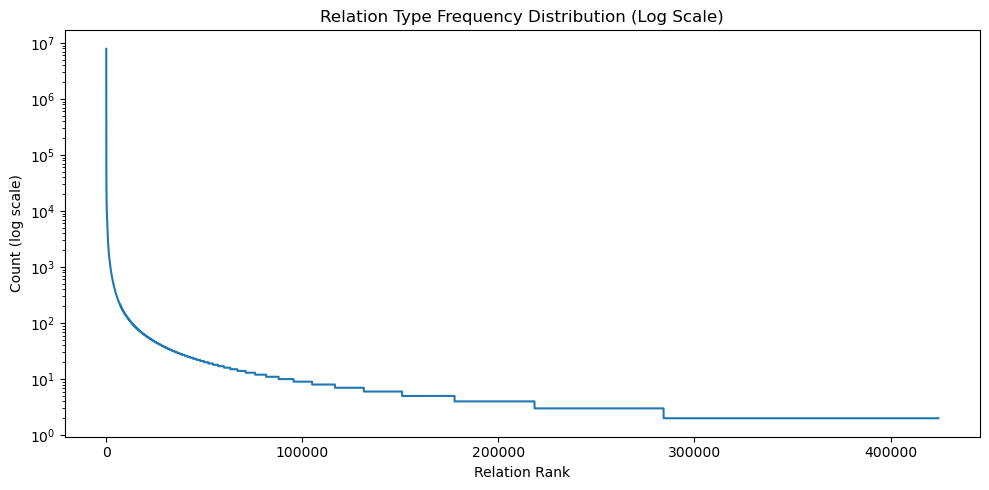

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np

# Get all counts and sort descending
counts = sorted(filtered_relations.values(), reverse=True)

# Plot
plt.figure(figsize=(10, 5))
plt.plot(counts)
plt.yscale('log')  # Log scale to handle skew
plt.title("Relation Type Frequency Distribution (Log Scale)")
plt.xlabel("Relation Rank")
plt.ylabel("Count (log scale)")
plt.tight_layout()
plt.show()


In [9]:
import json

# Path to your .jsonl file
file_path = 'zero_rel_all.jsonl'

# Read a single line from the .jsonl file
with open(file_path, 'r', encoding='utf-8') as file:
    line = file.readline()
    if line:
        data = json.loads(line)
        print(data)
    else:
        print("File is empty.")


{'ner': [[0, 2, 'DATE', '27 year old'], [5, 5, 'GPE', 'Amsterdam'], [7, 7, 'GPE', 'Netherlands'], [27, 27, 'PERSON', 'Renata'], [45, 45, 'GPE', 'Amsterdam'], [72, 72, 'PERSON', 'Renata'], [110, 111, 'DATE', '25 years']], 'relations': [{'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'}, 'tail': {'mention': 'Amsterdam', 'position': [5, 5], 'type': 'GPE'}, 'relation_text': 'from location', 'raw_relation_text': '    FROM_LOCATION'}, {'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'}, 'tail': {'mention': 'Netherlands', 'position': [7, 7], 'type': 'GPE'}, 'relation_text': 'country of origin', 'raw_relation_text': '    COUNTRY_OF_ORIGIN'}, {'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'}, 'tail': {'mention': 'Renata', 'position': [27, 27], 'type': 'PERSON'}, 'relation_text': 'agent of', 'raw_relation_text': '    AGENT_OF'}, {'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'}, 'tail': {'mention': 'Amsterdam', 

In [10]:
data

{'ner': [[0, 2, 'DATE', '27 year old'],
  [5, 5, 'GPE', 'Amsterdam'],
  [7, 7, 'GPE', 'Netherlands'],
  [27, 27, 'PERSON', 'Renata'],
  [45, 45, 'GPE', 'Amsterdam'],
  [72, 72, 'PERSON', 'Renata'],
  [110, 111, 'DATE', '25 years']],
 'relations': [{'head': {'mention': '27 year old',
    'position': [0, 2],
    'type': 'DATE'},
   'tail': {'mention': 'Amsterdam', 'position': [5, 5], 'type': 'GPE'},
   'relation_text': 'from location',
   'raw_relation_text': '    FROM_LOCATION'},
  {'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'},
   'tail': {'mention': 'Netherlands', 'position': [7, 7], 'type': 'GPE'},
   'relation_text': 'country of origin',
   'raw_relation_text': '    COUNTRY_OF_ORIGIN'},
  {'head': {'mention': '27 year old', 'position': [0, 2], 'type': 'DATE'},
   'tail': {'mention': 'Renata', 'position': [27, 27], 'type': 'PERSON'},
   'relation_text': 'agent of',
   'raw_relation_text': '    AGENT_OF'},
  {'head': {'mention': '27 year old', 'position': [0, 